In [4]:
import cv2
import numpy as np

# === Initialisation ===
video_path = r"D:\Cours Vision par ordinateur\cours_vision\Walk3.mpg"  # mets le bon chemin exact ici
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    print("❌ Erreur : impossible d’ouvrir la vidéo.")
    exit()

line_position = 300
entrants, sortants = 0, 0

# === Construction du fond ===
frames = []
for i in range(30):
    ret, frame = cap.read()
    if not ret:
        print(f"⚠️ Frame {i} non lue.")
        continue
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    frames.append(gray)

if len(frames) == 0:
    print("❌ Erreur : aucune frame n’a été lue pour construire le fond.")
    exit()

print(f"✅ {len(frames)} frames chargées pour le fond.")
background = np.median(frames, axis=0).astype(np.uint8)

# === Kalman Filter ===
kalman = cv2.KalmanFilter(4, 2)
kalman.measurementMatrix = np.array([[1,0,0,0], [0,1,0,0]], np.float32)
kalman.transitionMatrix = np.array([[1,0,1,0], [0,1,0,1], [0,0,1,0], [0,0,0,1]], np.float32)
kalman.processNoiseCov = np.eye(4, dtype=np.float32) * 0.03

prev_center = None
cap.set(cv2.CAP_PROP_POS_FRAMES, 0)  # Revenir au début

# === Traitement ===
while True:
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    fg_mask = cv2.absdiff(gray, background)
    _, thresh = cv2.threshold(fg_mask, 30, 255, cv2.THRESH_BINARY)

    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
    clean = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)
    clean = cv2.morphologyEx(clean, cv2.MORPH_CLOSE, kernel)

    contours, _ = cv2.findContours(clean, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    for cnt in contours:
        if cv2.contourArea(cnt) < 500:
            continue
        x, y, w, h = cv2.boundingRect(cnt)
        cx, cy = x + w//2, y + h//2
        cv2.rectangle(frame, (x, y), (x + w, y + h), (255, 0, 0), 2)

        measurement = np.array([[np.float32(cx)], [np.float32(cy)]])
        kalman.correct(measurement)
        prediction = kalman.predict()
        pred_x, pred_y = int(prediction[0]), int(prediction[1])
        corrected = kalman.statePost
        corr_x, corr_y = int(corrected[0]), int(corrected[1])

        cv2.circle(frame, (cx, cy), 5, (0, 255, 0), -1)
        cv2.circle(frame, (pred_x, pred_y), 5, (255, 0, 0), -1)
        cv2.circle(frame, (corr_x, corr_y), 5, (0, 0, 255), -1)

        if prev_center:
            if prev_center[1] < line_position and cy >= line_position:
                entrants += 1
            elif prev_center[1] > line_position and cy <= line_position:
                sortants += 1
        prev_center = (cx, cy)

    cv2.line(frame, (0, line_position), (frame.shape[1], line_position), (0, 255, 255), 2)
    cv2.putText(frame, f"Entrants: {entrants}", (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
    cv2.putText(frame, f"Sortants: {sortants}", (10, 70), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)

    cv2.imshow('TP2 - Détection & Suivi', frame)
    if cv2.waitKey(30) & 0xFF == 27:
        break

cap.release()
cv2.destroyAllWindows()
print("✅ Traitement terminé.")
print(f"Entrants: {entrants}, Sortants: {sortants}")
print("✅ Vidéo fermée.")
print("✅ Fenêtres détruites.")
print("✅ Fin du programme.")
print("✅ Fin du traitement.")


✅ 30 frames chargées pour le fond.


C:\Users\Nael_Gaizka\AppData\Local\Temp\ipykernel_14952\2935883737.py:67: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  pred_x, pred_y = int(prediction[0]), int(prediction[1])
C:\Users\Nael_Gaizka\AppData\Local\Temp\ipykernel_14952\2935883737.py:69: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  corr_x, corr_y = int(corrected[0]), int(corrected[1])


✅ Traitement terminé.
Entrants: 0, Sortants: 0
✅ Vidéo fermée.
✅ Fenêtres détruites.
✅ Fin du programme.
✅ Fin du traitement.


In [5]:
print(f"Centre détecté : ({cx}, {cy})")
print(f"Prédiction : ({pred_x}, {pred_y})")

Centre détecté : (242, 28)
Prédiction : (227, 43)


In [16]:
import cv2
import numpy as np

# === Initialisation ===
video_path = 'Walk3.mpg'  # Remplace si besoin
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    print("❌ Impossible d’ouvrir la vidéo.")
    exit()

fps = int(cap.get(cv2.CAP_PROP_FPS))
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# === Enregistrement vidéo ===
out = cv2.VideoWriter('video_resultat.avi',
                      cv2.VideoWriter_fourcc(*'XVID'),
                      fps,
                      (frame_width, frame_height))

line_position = 250
entrants, sortants = 0, 0
print(f"📍 Position de la ligne de comptage : {line_position}")

# === Construction du fond (médiane des 30 premières frames) ===
frames = []
for i in range(30):
    ret, frame = cap.read()
    if not ret:
        break
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    frames.append(gray)
background = np.median(frames, axis=0).astype(np.uint8)
print("✅ Fond construit.")

# === Revenir au début
cap.set(cv2.CAP_PROP_POS_FRAMES, 0)
prev_centers = []

while True:
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    fg_mask = cv2.absdiff(gray, background)
    _, thresh = cv2.threshold(fg_mask, 30, 255, cv2.THRESH_BINARY)

    # Nettoyage bruit
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5,5))
    clean = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)
    clean = cv2.morphologyEx(clean, cv2.MORPH_CLOSE, kernel)

    contours, _ = cv2.findContours(clean, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    current_centers = []

    for cnt in contours:
        if cv2.contourArea(cnt) < 500:
            continue

        x, y, w, h = cv2.boundingRect(cnt)
        cx, cy = x + w//2, y + h//2
        current_centers.append((cx, cy))

        # Dessiner boîte et centre
        cv2.rectangle(frame, (x, y), (x+w, y+h), (255, 0, 0), 2)
        cv2.circle(frame, (cx, cy), 5, (0, 255, 0), -1)

        # Comparer avec positions précédentes
        for pcx, pcy in prev_centers:
            if abs(pcx - cx) < 50:
                if pcy < line_position and cy >= line_position:
                    entrants += 1
                elif pcy > line_position and cy <= line_position:
                    sortants += 1

    prev_centers = current_centers.copy()

    # Affichage
    cv2.line(frame, (0, line_position), (frame.shape[1], line_position), (0, 0, 255), 2)
    cv2.putText(frame, f"Entrants: {entrants}", (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0,255,0), 2)
    cv2.putText(frame, f"Sortants: {sortants}", (10, 70), cv2.FONT_HERSHEY_SIMPLEX, 1, (0,0,255), 2)

    out.write(frame)
    cv2.imshow('Comptage avec détection', frame)

    if cv2.waitKey(30) & 0xFF == ord('q'):
        break

# === Nettoyage
cap.release()
out.release()
cv2.destroyAllWindows()
print("🎥 Vidéo enregistrée : video_resultat.avi")
print(f"📊 Total entrants : {entrants} | sortants : {sortants}")
print("✅ Traitement terminé.")


📍 Position de la ligne de comptage : 250
✅ Fond construit.
🎥 Vidéo enregistrée : video_resultat.avi
📊 Total entrants : 1 | sortants : 2
✅ Traitement terminé.


In [22]:
import cv2
import numpy as np

# === Initialisation ===
video_path = 'Walk3.mpg'  # Mets ici le nom exact du fichier vidéo
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    raise IOError(f"Erreur : impossible d'ouvrir la vidéo {video_path}")

# === Construction du fond (médiane sur 30 frames) ===
frames = []
for i in range(30):
    ret, frame = cap.read()
    if not ret:
        break
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    frames.append(gray)

if not frames:
    raise ValueError("Erreur : aucune frame lue pour le fond.")

background = np.median(frames, axis=0).astype(np.uint8)

# Revenir au début
cap.set(cv2.CAP_PROP_POS_FRAMES, 0)

# === Kalman filter ===
kalman = cv2.KalmanFilter(4, 2)
kalman.measurementMatrix = np.array([[1, 0, 0, 0],
                                     [0, 1, 0, 0]], np.float32)
kalman.transitionMatrix = np.array([[1, 0, 1, 0],
                                    [0, 1, 0, 1],
                                    [0, 0, 1, 0],
                                    [0, 0, 0, 1]], np.float32)
kalman.processNoiseCov = np.eye(4, dtype=np.float32) * 0.03

# === Variables pour suivi et comptage ===
prev_center = None
entrants, sortants = 0, 0
line_y = 250  # Position de la ligne de comptage

# === Boucle principale ===
while True:
    ret, frame = cap.read()
    if not ret:
        break

    output = frame.copy()
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    fg_mask = cv2.absdiff(gray, background)
    _, thresh = cv2.threshold(fg_mask, 30, 255, cv2.THRESH_BINARY)

    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
    clean = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)
    clean = cv2.morphologyEx(clean, cv2.MORPH_CLOSE, kernel)

    contours, _ = cv2.findContours(clean, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    for cnt in contours:
        if cv2.contourArea(cnt) < 500:
            continue

        x, y, w, h = cv2.boundingRect(cnt)
        cx, cy = x + w // 2, y + h // 2

        # Kalman tracking
        measurement = np.array([[np.float32(cx)], [np.float32(cy)]])
        kalman.correct(measurement)
        prediction = kalman.predict()
        pred_x, pred_y = int(prediction[0]), int(prediction[1])
        corrected = kalman.statePost
        corr_x, corr_y = int(corrected[0]), int(corrected[1])

        # Dessiner
        cv2.rectangle(output, (x, y), (x + w, y + h), (255, 255, 0), 2)
        cv2.circle(output, (cx, cy), 5, (0, 255, 0), -1)    # Mesure = vert
        cv2.circle(output, (pred_x, pred_y), 5, (255, 0, 0), -1)  # Prédiction = bleu
        cv2.circle(output, (corr_x, corr_y), 5, (0, 0, 255), -1)  # Correction = rouge

        # Comptage
        if prev_center:
            if prev_center[1] < line_y and cy >= line_y:
                entrants += 1
            elif prev_center[1] > line_y and cy <= line_y:
                sortants += 1
        prev_center = (cx, cy)

    # Ligne de comptage
    cv2.line(output, (0, line_y), (frame.shape[1], line_y), (0, 255, 255), 2)
    cv2.putText(output, f"Entrants: {entrants}", (10, 30),
                cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
    cv2.putText(output, f"Sortants: {sortants}", (10, 70),
                cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)

    cv2.imshow("TP2 - Vision par ordinateur", output)
    if cv2.waitKey(30) & 0xFF == 27:
        break

cap.release()
cv2.destroyAllWindows()
print("✅ Traitement terminé.")
print(f"Entrants: {entrants}, Sortants: {sortants}")

C:\Users\Nael_Gaizka\AppData\Local\Temp\ipykernel_14952\1736092830.py:71: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  pred_x, pred_y = int(prediction[0]), int(prediction[1])
C:\Users\Nael_Gaizka\AppData\Local\Temp\ipykernel_14952\1736092830.py:73: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  corr_x, corr_y = int(corrected[0]), int(corrected[1])


✅ Traitement terminé.
Entrants: 1, Sortants: 2


In [24]:
import cv2
import numpy as np
import csv
import os

# === Initialisation ===
video_path = 'Walk3.mpg'
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    raise IOError(f"Erreur : impossible d'ouvrir la vidéo {video_path}")

# === Construction du fond ===
frames = []
for i in range(30):
    ret, frame = cap.read()
    if not ret:
        break
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    frames.append(gray)

if not frames:
    raise ValueError("Erreur : aucune frame lue pour le fond.")
background = np.median(frames, axis=0).astype(np.uint8)
cap.set(cv2.CAP_PROP_POS_FRAMES, 0)

# === Kalman Filter ===
kalman = cv2.KalmanFilter(4, 2)
kalman.measurementMatrix = np.array([[1, 0, 0, 0],
                                     [0, 1, 0, 0]], np.float32)
kalman.transitionMatrix = np.array([[1, 0, 1, 0],
                                    [0, 1, 0, 1],
                                    [0, 0, 1, 0],
                                    [0, 0, 0, 1]], np.float32)
kalman.processNoiseCov = np.eye(4, dtype=np.float32) * 0.03

# === Variables ===
line_y = 250
entrants, sortants = 0, 0
prev_center = None
positions = []  # Liste des (frame_id, x, y)
frame_id = 0

# === Traitement des frames ===
while True:
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    fg_mask = cv2.absdiff(gray, background)
    _, thresh = cv2.threshold(fg_mask, 30, 255, cv2.THRESH_BINARY)

    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
    clean = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)
    clean = cv2.morphologyEx(clean, cv2.MORPH_CLOSE, kernel)

    contours, _ = cv2.findContours(clean, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    output = frame.copy()

    for cnt in contours:
        if cv2.contourArea(cnt) < 500:
            continue

        x, y, w, h = cv2.boundingRect(cnt)
        cx, cy = x + w // 2, y + h // 2

        # Correction et prédiction Kalman
        measurement = np.array([[np.float32(cx)], [np.float32(cy)]])
        kalman.correct(measurement)
        prediction = kalman.predict()
        corr_x, corr_y = int(kalman.statePost[0]), int(kalman.statePost[1])

        # Enregistrement de la position
        positions.append((frame_id, corr_x, corr_y))

        # Affichage
        cv2.rectangle(output, (x, y), (x + w, y + h), (255, 255, 0), 2)
        cv2.circle(output, (cx, cy), 5, (0, 255, 0), -1)       # Mesure - vert
        cv2.circle(output, (corr_x, corr_y), 5, (0, 0, 255), -1) # Corrigé - rouge

        # Comptage
        if prev_center:
            if prev_center[1] < line_y and cy >= line_y:
                entrants += 1
            elif prev_center[1] > line_y and cy <= line_y:
                sortants += 1
        prev_center = (cx, cy)

    # Affichage des infos
    cv2.line(output, (0, line_y), (frame.shape[1], line_y), (0, 255, 255), 2)
    cv2.putText(output, f"Entrants: {entrants}", (10, 30),
                cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
    cv2.putText(output, f"Sortants: {sortants}", (10, 70),
                cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)

    cv2.imshow("TP2 - Compter les passagers", output)
    if cv2.waitKey(30) & 0xFF == 27:
        break

    frame_id += 1

cap.release()
cv2.destroyAllWindows()

# === Export CSV ===
with open("coordonnees_deplacement.csv", mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(["Frame", "X", "Y"])
    writer.writerows(positions)

print("✅ Export des coordonnées terminé : coordonnees_deplacement.csv")


C:\Users\Nael_Gaizka\AppData\Local\Temp\ipykernel_14952\797533396.py:72: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  corr_x, corr_y = int(kalman.statePost[0]), int(kalman.statePost[1])


✅ Export des coordonnées terminé : coordonnees_deplacement.csv


In [25]:
import cv2
import numpy as np
import csv
import os

# === Initialisation ===
video_path = 'Walk3.mpg'
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    raise IOError(f"Erreur : impossible d'ouvrir la vidéo {video_path}")

# === Créer un dossier pour sauvegarder les images ===
os.makedirs("captures", exist_ok=True)

# === Construction du fond (médiane sur les 30 premières frames) ===
frames = []
for i in range(30):
    ret, frame = cap.read()
    if not ret:
        break
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    frames.append(gray)

if not frames:
    raise ValueError("Erreur : aucune frame lue pour le fond.")
background = np.median(frames, axis=0).astype(np.uint8)
cap.set(cv2.CAP_PROP_POS_FRAMES, 0)

# === Kalman Filter ===
kalman = cv2.KalmanFilter(4, 2)
kalman.measurementMatrix = np.array([[1, 0, 0, 0],
                                     [0, 1, 0, 0]], np.float32)
kalman.transitionMatrix = np.array([[1, 0, 1, 0],
                                    [0, 1, 0, 1],
                                    [0, 0, 1, 0],
                                    [0, 0, 0, 1]], np.float32)
kalman.processNoiseCov = np.eye(4, dtype=np.float32) * 0.03

# === Variables ===
line_y = 250
entrants, sortants = 0, 0
prev_center = None
positions = []  # Liste des (frame_id, x, y)
frame_id = 0

# === Traitement des frames ===
while True:
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    fg_mask = cv2.absdiff(gray, background)
    _, thresh = cv2.threshold(fg_mask, 30, 255, cv2.THRESH_BINARY)

    # Morphologie pour nettoyer
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
    clean = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)
    clean = cv2.morphologyEx(clean, cv2.MORPH_CLOSE, kernel)

    contours, _ = cv2.findContours(clean, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    output = frame.copy()

    for cnt in contours:
        if cv2.contourArea(cnt) < 500:
            continue

        # Boîte englobante et centre
        x, y, w, h = cv2.boundingRect(cnt)
        cx, cy = x + w // 2, y + h // 2

        # Kalman
        measurement = np.array([[np.float32(cx)], [np.float32(cy)]])
        kalman.correct(measurement)
        prediction = kalman.predict()
        corr_x, corr_y = int(kalman.statePost[0]), int(kalman.statePost[1])

        # Enregistrement des coordonnées
        positions.append((frame_id, corr_x, corr_y))

        # Affichage des coordonnées
        cv2.rectangle(output, (x, y), (x + w, y + h), (255, 255, 0), 2)
        cv2.circle(output, (cx, cy), 5, (0, 255, 0), -1)       # Mesure - vert
        cv2.circle(output, (corr_x, corr_y), 5, (0, 0, 255), -1) # Correction - rouge

        # Ligne de comptage
        if prev_center:
            if prev_center[1] < line_y and cy >= line_y:
                entrants += 1
            elif prev_center[1] > line_y and cy <= line_y:
                sortants += 1
        prev_center = (cx, cy)

        # Sauvegarde de l'image annotée
        annotated = output.copy()
        text = f"Frame: {frame_id}, Coords: ({corr_x}, {corr_y})"
        cv2.putText(annotated, text, (10, annotated.shape[0] - 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2)
        img_path = f"captures/frame_{frame_id}_x{corr_x}_y{corr_y}.png"
        cv2.imwrite(img_path, annotated)

    # Dessiner la ligne + compteur
    cv2.line(output, (0, line_y), (frame.shape[1], line_y), (0, 255, 255), 2)
    cv2.putText(output, f"Entrants: {entrants}", (10, 30),
                cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
    cv2.putText(output, f"Sortants: {sortants}", (10, 70),
                cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)

    cv2.imshow("TP2 - Compter les passagers", output)
    if cv2.waitKey(30) & 0xFF == 27:  # ESC pour quitter
        break

    frame_id += 1

cap.release()
cv2.destroyAllWindows()

# === Export CSV des positions ===
with open("coordonnees_deplacement.csv", mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(["Frame", "X", "Y"])
    writer.writerows(positions)

print("✅ Export terminé : 'coordonnees_deplacement.csv' et images annotées dans 'captures/'")


C:\Users\Nael_Gaizka\AppData\Local\Temp\ipykernel_14952\3215105509.py:77: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  corr_x, corr_y = int(kalman.statePost[0]), int(kalman.statePost[1])


✅ Export terminé : 'coordonnees_deplacement.csv' et images annotées dans 'captures/'


C:\Users\Nael_Gaizka\AppData\Local\Temp\ipykernel_14952\2939227180.py:72: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  corr_x, corr_y = int(kalman.statePost[0]), int(kalman.statePost[1])


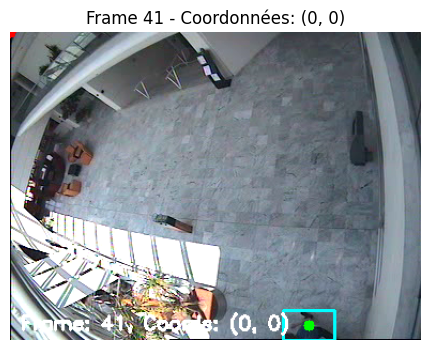

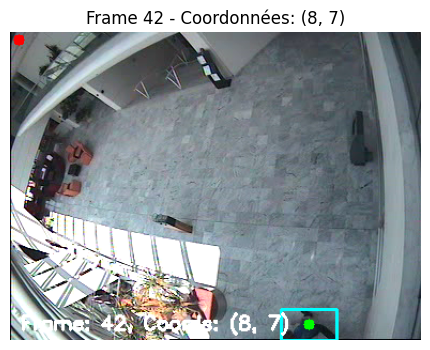

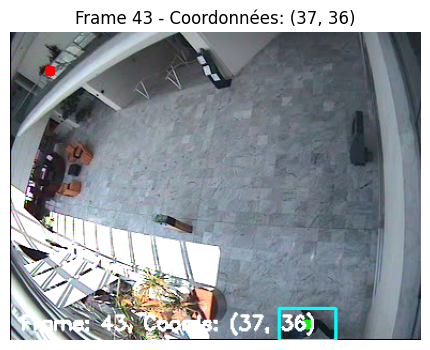

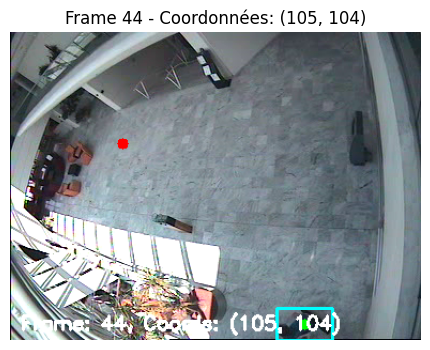

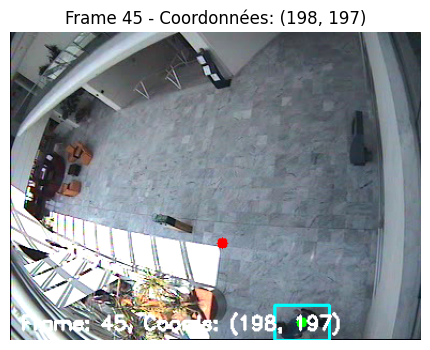

...

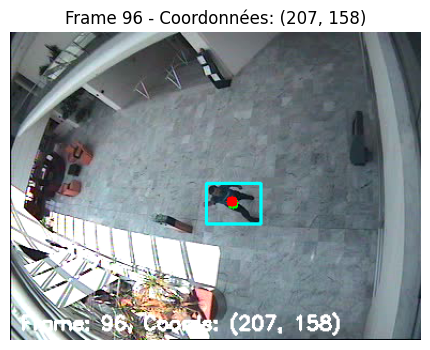

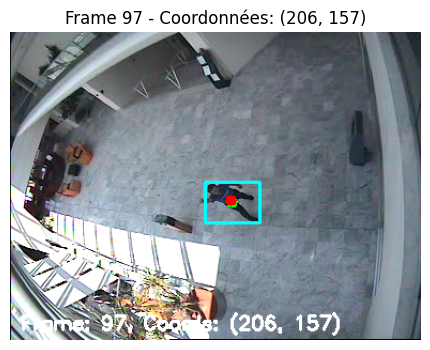

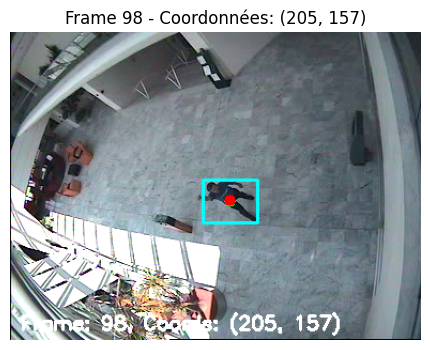

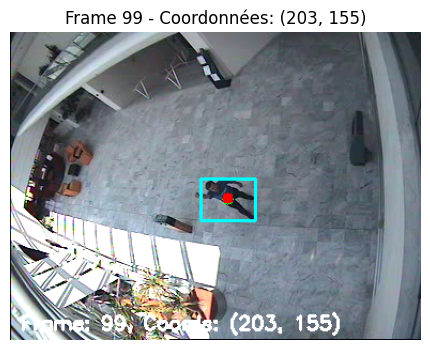

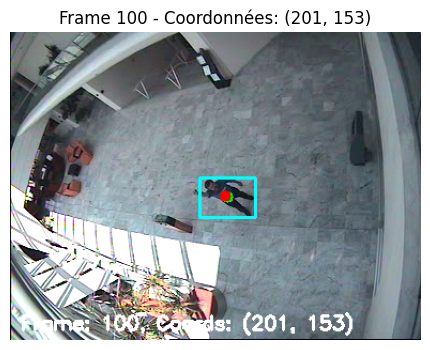

In [27]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# === Initialisation ===
video_path = 'Walk3.mpg'
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    raise IOError(f"Erreur : impossible d'ouvrir la vidéo {video_path}")

# === Construction du fond (médiane sur les 30 premières frames) ===
frames = []
for i in range(30):
    ret, frame = cap.read()
    if not ret:
        break
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    frames.append(gray)

if not frames:
    raise ValueError("Erreur : aucune frame lue pour le fond.")
background = np.median(frames, axis=0).astype(np.uint8)
cap.set(cv2.CAP_PROP_POS_FRAMES, 0)

# === Kalman Filter ===
kalman = cv2.KalmanFilter(4, 2)
kalman.measurementMatrix = np.array([[1, 0, 0, 0],
                                     [0, 1, 0, 0]], np.float32)
kalman.transitionMatrix = np.array([[1, 0, 1, 0],
                                    [0, 1, 0, 1],
                                    [0, 0, 1, 0],
                                    [0, 0, 0, 1]], np.float32)
kalman.processNoiseCov = np.eye(4, dtype=np.float32) * 0.03

# === Variables ===
line_y = 250
entrants, sortants = 0, 0
prev_center = None
positions = []  # Liste des (frame_id, x, y)
frame_id = 0
captured_images = []

# === Traitement des frames ===
while True:
    ret, frame = cap.read()
    if not ret or frame_id > 100:  # stop après 100 frames max
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    fg_mask = cv2.absdiff(gray, background)
    _, thresh = cv2.threshold(fg_mask, 30, 255, cv2.THRESH_BINARY)

    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
    clean = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)
    clean = cv2.morphologyEx(clean, cv2.MORPH_CLOSE, kernel)

    contours, _ = cv2.findContours(clean, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    output = frame.copy()

    for cnt in contours:
        if cv2.contourArea(cnt) < 500:
            continue

        x, y, w, h = cv2.boundingRect(cnt)
        cx, cy = x + w // 2, y + h // 2

        # Kalman
        measurement = np.array([[np.float32(cx)], [np.float32(cy)]])
        kalman.correct(measurement)
        prediction = kalman.predict()
        corr_x, corr_y = int(kalman.statePost[0]), int(kalman.statePost[1])
        positions.append((frame_id, corr_x, corr_y))

        # Annoter l'image
        cv2.rectangle(output, (x, y), (x + w, y + h), (255, 255, 0), 2)
        cv2.circle(output, (cx, cy), 5, (0, 255, 0), -1)       # vert = mesuré
        cv2.circle(output, (corr_x, corr_y), 5, (0, 0, 255), -1) # rouge = corrigé
        cv2.putText(output, f"Frame: {frame_id}, Coords: ({corr_x}, {corr_y})",
                    (10, output.shape[0] - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2)

        # Sauvegarder pour affichage dans le notebook
        rgb_img = cv2.cvtColor(output, cv2.COLOR_BGR2RGB)
        captured_images.append((rgb_img, frame_id, corr_x, corr_y))

        break  # On prend juste 1 personne par frame pour l’exemple

    frame_id += 1

cap.release()
cv2.destroyAllWindows()

# === Affichage dans le notebook ===
for img, frame_id, x, y in captured_images:
    plt.figure(figsize=(6, 4))
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Frame {frame_id} - Coordonnées: ({x}, {y})")
    plt.show()


C:\Users\Nael_Gaizka\AppData\Local\Temp\ipykernel_14952\2194128289.py:72: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  corr_x, corr_y = int(kalman.statePost[0]), int(kalman.statePost[1])


📸 Images capturées :


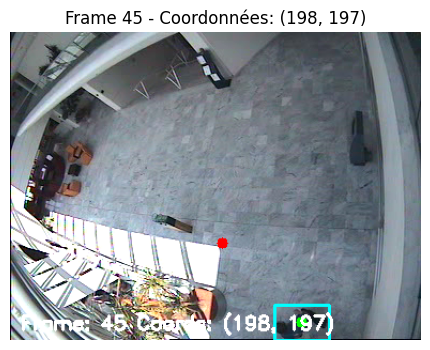

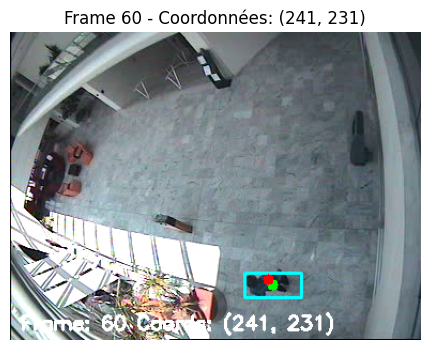

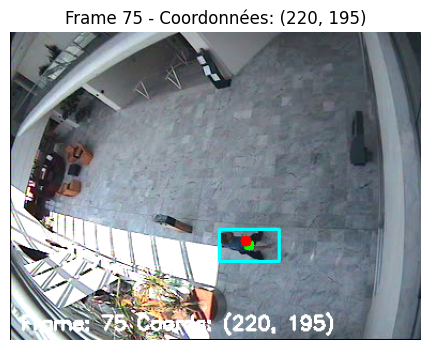

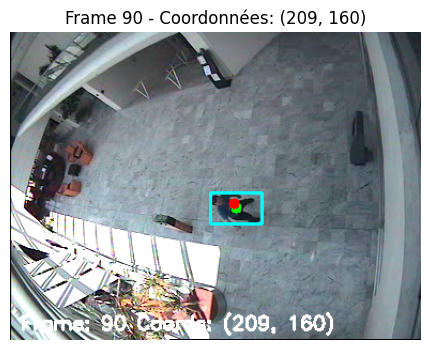

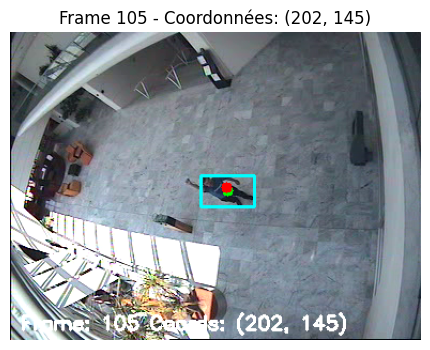

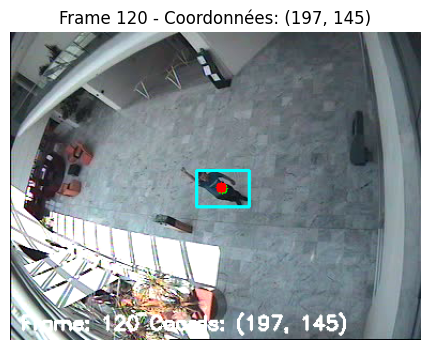

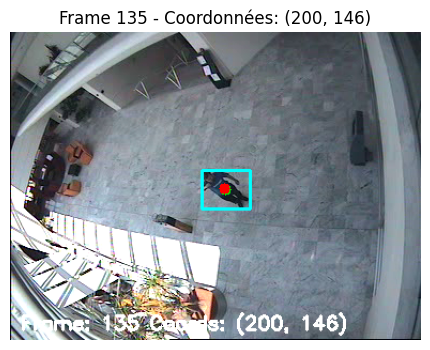

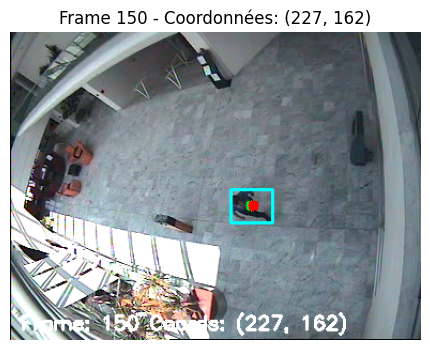

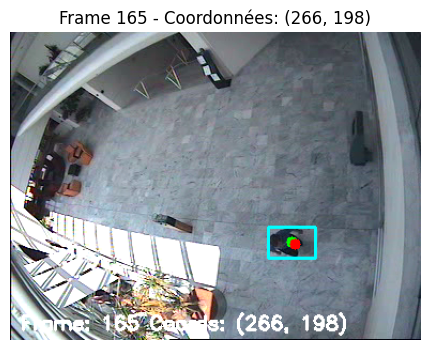

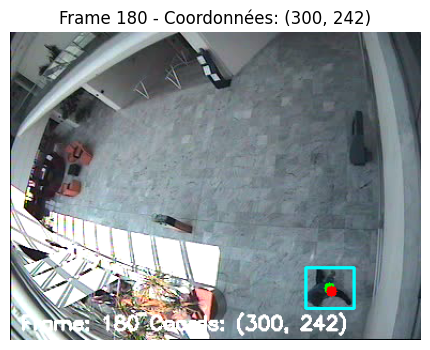

In [28]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# === Initialisation ===
video_path = 'Walk3.mpg'  # Ton fichier vidéo
cap = cv2.VideoCapture(video_path)

if not cap.isOpened():
    raise IOError(f"Erreur : impossible d'ouvrir la vidéo {video_path}")

# === Construction du fond (sur les 30 premières frames) ===
frames = []
for i in range(30):
    ret, frame = cap.read()
    if not ret:
        break
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    frames.append(gray)

if not frames:
    raise ValueError("Erreur : aucune frame lue pour le fond.")
background = np.median(frames, axis=0).astype(np.uint8)
cap.set(cv2.CAP_PROP_POS_FRAMES, 0)

# === Initialisation Kalman ===
kalman = cv2.KalmanFilter(4, 2)
kalman.measurementMatrix = np.array([[1, 0, 0, 0],
                                     [0, 1, 0, 0]], np.float32)
kalman.transitionMatrix = np.array([[1, 0, 1, 0],
                                    [0, 1, 0, 1],
                                    [0, 0, 1, 0],
                                    [0, 0, 0, 1]], np.float32)
kalman.processNoiseCov = np.eye(4, dtype=np.float32) * 0.03

# === Variables ===
line_y = 250
entrants, sortants = 0, 0
prev_center = None
frame_id = 0
positions = []
captured_images = []

# === Boucle principale : traitement + affichage direct ===
while True:
    ret, frame = cap.read()
    if not ret or frame_id > 200:  # Stop après 200 frames
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    fg_mask = cv2.absdiff(gray, background)
    _, thresh = cv2.threshold(fg_mask, 30, 255, cv2.THRESH_BINARY)

    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
    clean = cv2.morphologyEx(thresh, cv2.MORPH_OPEN, kernel)
    clean = cv2.morphologyEx(clean, cv2.MORPH_CLOSE, kernel)

    contours, _ = cv2.findContours(clean, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    output = frame.copy()

    for cnt in contours:
        if cv2.contourArea(cnt) < 500:
            continue

        x, y, w, h = cv2.boundingRect(cnt)
        cx, cy = x + w // 2, y + h // 2

        # Kalman
        measurement = np.array([[np.float32(cx)], [np.float32(cy)]])
        kalman.correct(measurement)
        prediction = kalman.predict()
        corr_x, corr_y = int(kalman.statePost[0]), int(kalman.statePost[1])
        positions.append((frame_id, corr_x, corr_y))

        # Comptage
        if prev_center:
            if prev_center[1] < line_y and cy >= line_y:
                entrants += 1
            elif prev_center[1] > line_y and cy <= line_y:
                sortants += 1
        prev_center = (cx, cy)

        # Dessin
        cv2.rectangle(output, (x, y), (x + w, y + h), (255, 255, 0), 2)
        cv2.circle(output, (cx, cy), 5, (0, 255, 0), -1)
        cv2.circle(output, (corr_x, corr_y), 5, (0, 0, 255), -1)
        cv2.putText(output, f"Frame: {frame_id} Coords: ({corr_x}, {corr_y})",
                    (10, output.shape[0] - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6,
                    (255, 255, 255), 2)

        # Capture une image toutes les 15 frames
        if frame_id % 15 == 0:
            rgb_img = cv2.cvtColor(output, cv2.COLOR_BGR2RGB)
            captured_images.append((rgb_img, frame_id, corr_x, corr_y))

        break  # un seul objet par frame pour cet exemple

    # Ligne et infos
    cv2.line(output, (0, line_y), (frame.shape[1], line_y), (0, 255, 255), 2)
    cv2.putText(output, f"Entrants: {entrants}", (10, 30),
                cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
    cv2.putText(output, f"Sortants: {sortants}", (10, 70),
                cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)

    # Affichage temps réel
    cv2.imshow("TP2 - Suivi en direct", output)
    if cv2.waitKey(30) & 0xFF == 27:  # ESC
        break

    frame_id += 1

cap.release()
cv2.destroyAllWindows()

# === Affichage final dans le notebook ===
print("📸 Images capturées :")
for img, fid, x, y in captured_images:
    plt.figure(figsize=(6, 4))
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Frame {fid} - Coordonnées: ({x}, {y})")
    plt.show()
